# RESNET

In [5]:
import json
import os
import requests
from IPython.display import Image
from PIL import Image as PilImage, ImageDraw, ImageFont, ImageColor
from io import BytesIO

HF_API_KEY = os.getenv('HF_API_KEY')
headers = {"Authorization": f"Bearer {HF_API_KEY}"}

def get_image_content(url):
  response = requests.get(url)
  return response.content

def query_facebook_resnet50(image_content):
  url = 'https://api-inference.huggingface.co/models/facebook/detr-resnet-50'
  response = requests.post(url, headers=headers, data=image_content)
  return response.json()

def query_microsoft_resnet152(image_content):
  url = 'https://api-inference.huggingface.co/models/microsoft/resnet-152'
  response = requests.post(url, headers=headers, data=image_content)
  return response.json()

## Image Classification with microsoft/resnet-152

In [6]:
def image_classification(image_url):
  image_content = get_image_content(image_url)
  output = query_microsoft_resnet152(image_content)

  for index, item in enumerate(output):
    print(f"{int(index) + 1}. {item['label']}, {item['score']}")

  image = PilImage.open(BytesIO(image_content))
  display(image)

### Dog

1. ocarina, sweet potato, 0.45897021889686584
2. mask, 0.03292689472436905
3. oxygen mask, 0.028369981795549393
4. candle, taper, wax light, 0.027844641357660294
5. sunscreen, sunblock, sun blocker, 0.019279805943369865


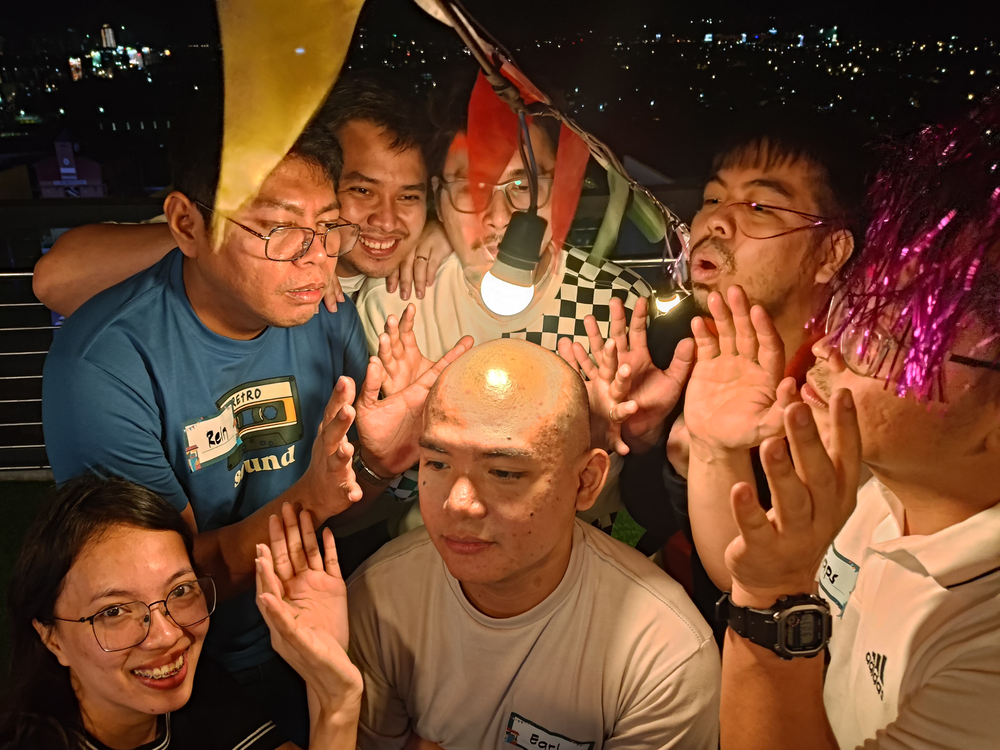

In [15]:
image_classification('https://onedrive.live.com/embed?resid=77AA3AF3CC49E1C1%2121811&authkey=%21APzfXrujsE3zJzo&width=4096&height=3072')

### Lighthouse

1. beacon, lighthouse, beacon light, pharos, 0.8121598362922668
2. water tower, 0.0037537289317697287
3. picket fence, paling, 0.0026241051964461803
4. breakwater, groin, groyne, mole, bulwark, seawall, jetty, 0.0013770652003586292
5. castle, 0.0010604679118841887


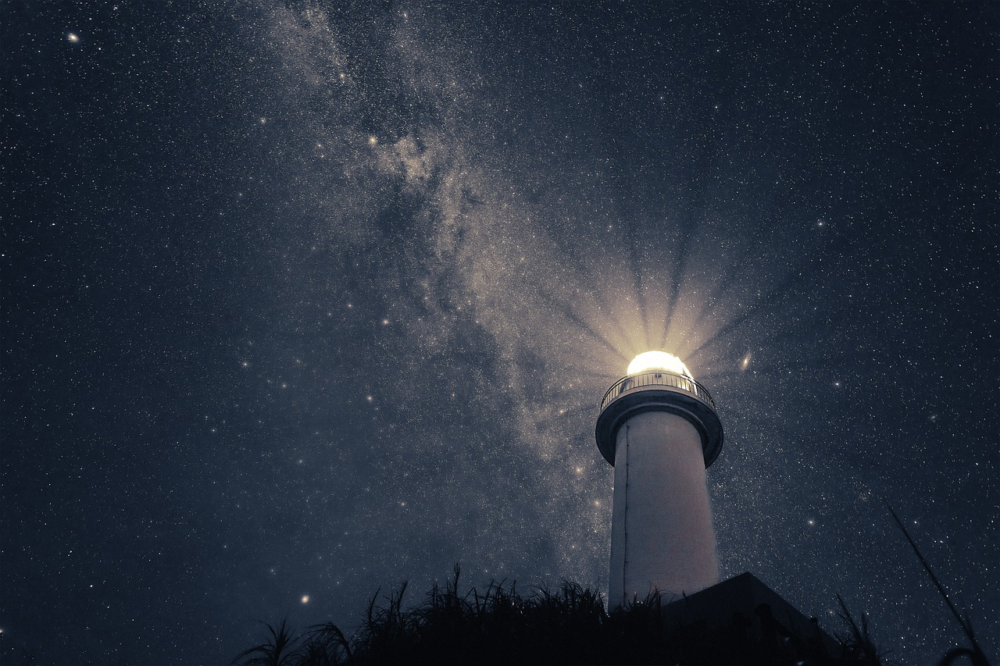

In [8]:
image_classification('https://cdn.pixabay.com/photo/2021/11/11/09/12/lighthouse-6785763_1280.jpg')

## End-to-End Object Detection with facebook/detr-resnet-50

In [9]:
def object_detection(image_url):
  image_content = get_image_content(image_url)

  output = query_facebook_resnet50(image_content)

  text_height = 40
  font = ImageFont.truetype("arial", 40)
  colors = ["red", "green", "blue", "purple", "orange", "pink", "cyan", "magenta", "lime", "teal", "lavender", "maroon", "navy", "olive", "silver", "gold", "black", "brown", "beige", "gray"]

  # Convert bytes to PIL Image
  image = PilImage.open(BytesIO(image_content))

  draw_layer = PilImage.new('RGBA', image.size, (255, 255, 255, 100))
  draw = ImageDraw.Draw(draw_layer)


  for index, item in enumerate(output):
    box = item["box"]
    color = colors[index % len(colors)]  # Choose a color by index

    print(f"{item['label']} - {color} - {box}")

    # Convert the color name to RGB
    rgb_color = ImageColor.getrgb(color)

    # Create a semi-transparent version of the color
    fill_color = rgb_color + (255,)  # 0 to 255 for alpha, adjust to your liking

    # Draw the rectangle with the fill color and outline color
    draw.rectangle([(box["xmin"], box["ymin"]), (box["xmax"], box["ymax"])], fill=(255, 0, 0, 10), outline=rgb_color, width=5)

    # Calculate the width of the text
    text_width = draw.textlength(item["label"], font=font)

    # Calculate the position for the text to be at the top center of the box
    text_position = ((box["xmin"] + box["xmax"]) // 2 - text_width // 2, box["ymin"] - text_height - 5)

    # If the text would be placed outside the image, place it at the bottom of the box instead
    if text_position[1] < 0:
      text_position = ((box["xmin"] + box["xmax"]) // 2 - text_width // 2, box["ymax"] + 5)
    
    # Add text
    draw.text(text_position, item["label"], fill=color, font=font)

  # Assuming draw_layer is an image with alpha channel
  image.paste(draw_layer, (0,0), mask=draw_layer)

  display(image)

### Dogs

dog - red - {'xmin': 572, 'ymin': 506, 'xmax': 770, 'ymax': 749}
dog - green - {'xmin': 572, 'ymin': 295, 'xmax': 895, 'ymax': 702}
dog - blue - {'xmin': 376, 'ymin': 238, 'xmax': 571, 'ymax': 654}
dog - purple - {'xmin': 0, 'ymin': 375, 'xmax': 436, 'ymax': 766}
dog - orange - {'xmin': 517, 'ymin': 128, 'xmax': 697, 'ymax': 598}


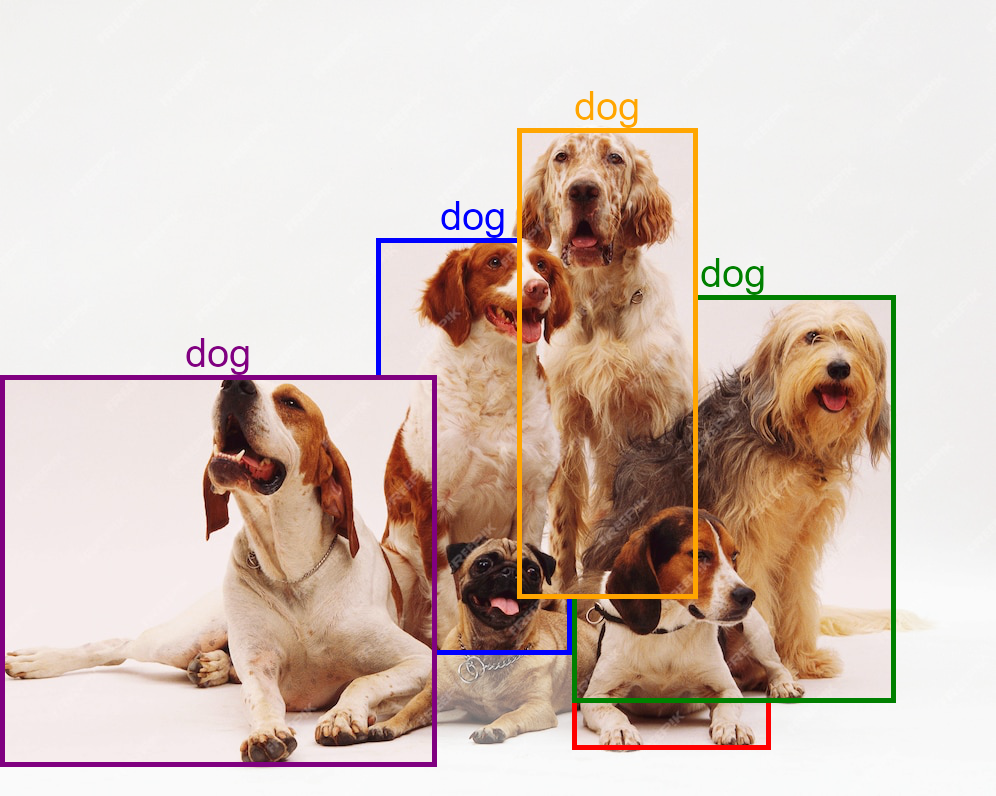

In [10]:
object_detection('https://img.freepik.com/free-photo/beautiful-shot-different-dog-breeds-resting_181624-19887.jpg?w=996&t=st=1706182558~exp=1706183158~hmac=f4b311a75d4f5ca2ac7063232cfd09f3b739d6c2ef56bad4ca1423bb6a338cb4')

### Dogs and Cupcakes

dog - red - {'xmin': 608, 'ymin': 301, 'xmax': 710, 'ymax': 356}
dog - green - {'xmin': 704, 'ymin': 97, 'xmax': 803, 'ymax': 195}
cake - blue - {'xmin': 202, 'ymin': 7, 'xmax': 300, 'ymax': 94}
cake - purple - {'xmin': 711, 'ymin': 6, 'xmax': 805, 'ymax': 91}
dog - orange - {'xmin': 207, 'ymin': 299, 'xmax': 263, 'ymax': 348}
dog - pink - {'xmin': 98, 'ymin': 196, 'xmax': 204, 'ymax': 293}
dog - cyan - {'xmin': 501, 'ymin': 293, 'xmax': 606, 'ymax': 354}
dog - magenta - {'xmin': 0, 'ymin': 291, 'xmax': 115, 'ymax': 353}


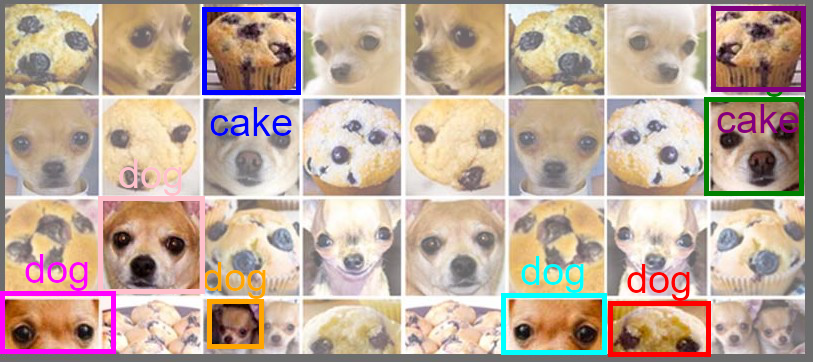

In [11]:
object_detection('https://onedrive.live.com/embed?resid=77AA3AF3CC49E1C1%2121810&authkey=%21AF0CDYwkEXKlHJQ&width=813&height=362')

### Busy street

bicycle - red - {'xmin': 119, 'ymin': 398, 'xmax': 212, 'ymax': 590}
bicycle - green - {'xmin': 690, 'ymin': 372, 'xmax': 764, 'ymax': 550}
person - blue - {'xmin': 752, 'ymin': 239, 'xmax': 869, 'ymax': 549}
bicycle - purple - {'xmin': 786, 'ymin': 396, 'xmax': 846, 'ymax': 573}
bicycle - orange - {'xmin': 454, 'ymin': 392, 'xmax': 500, 'ymax': 536}
person - pink - {'xmin': 859, 'ymin': 250, 'xmax': 962, 'ymax': 499}
person - cyan - {'xmin': 435, 'ymin': 276, 'xmax': 497, 'ymax': 405}
bus - magenta - {'xmin': 247, 'ymin': 0, 'xmax': 742, 'ymax': 441}
bicycle - lime - {'xmin': 565, 'ymin': 386, 'xmax': 608, 'ymax': 496}
person - teal - {'xmin': 0, 'ymin': 289, 'xmax': 95, 'ymax': 517}
car - lavender - {'xmin': 155, 'ymin': 268, 'xmax': 429, 'ymax': 497}
person - maroon - {'xmin': 252, 'ymin': 275, 'xmax': 378, 'ymax': 530}
bicycle - navy - {'xmin': 257, 'ymin': 393, 'xmax': 387, 'ymax': 560}
person - olive - {'xmin': 92, 'ymin': 278, 'xmax': 220, 'ymax': 570}
person - silver - {'xmin':

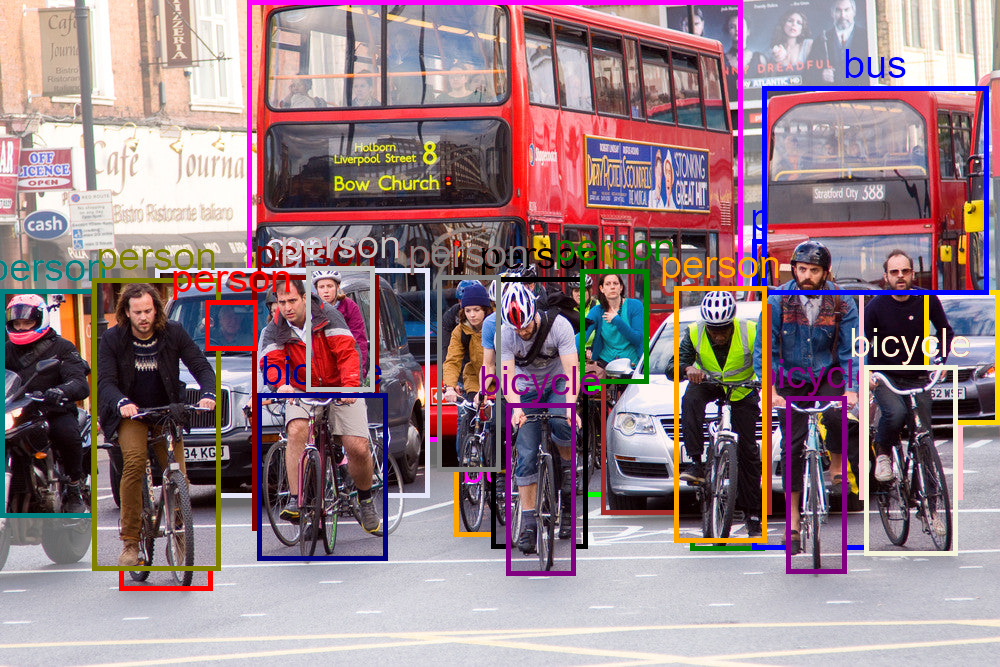

In [12]:
object_detection('https://cdn.shopify.com/s/files/1/0670/8717/articles/shutterstock_211943116_1200x1200.jpg?v=1472662829')

### Jarvis + Nexus Team

person - red - {'xmin': 15, 'ymin': 1931, 'xmax': 1479, 'ymax': 3047}
person - green - {'xmin': 1247, 'ymin': 304, 'xmax': 1862, 'ymax': 1433}
person - blue - {'xmin': 2758, 'ymin': 472, 'xmax': 4092, 'ymax': 3038}
person - purple - {'xmin': 144, 'ymin': 564, 'xmax': 1561, 'ymax': 2296}
person - orange - {'xmin': 1385, 'ymin': 1358, 'xmax': 2953, 'ymax': 3032}
person - pink - {'xmin': 2329, 'ymin': 487, 'xmax': 4091, 'ymax': 3039}


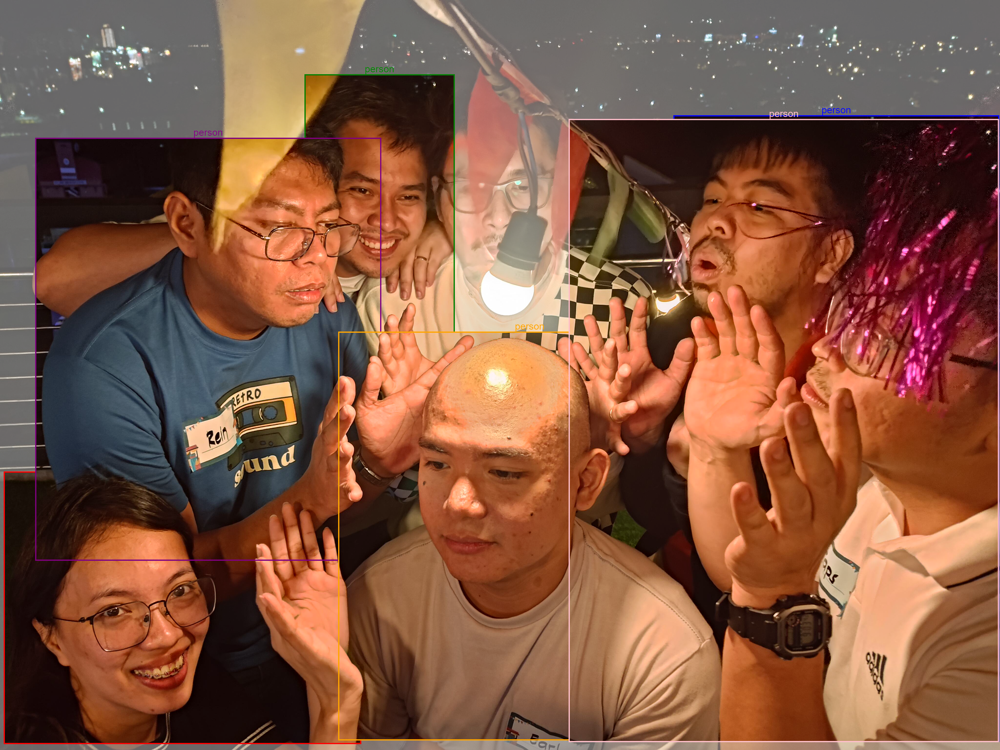

In [13]:
object_detection('https://onedrive.live.com/embed?resid=77AA3AF3CC49E1C1%2121811&authkey=%21APzfXrujsE3zJzo&width=4096&height=3072')